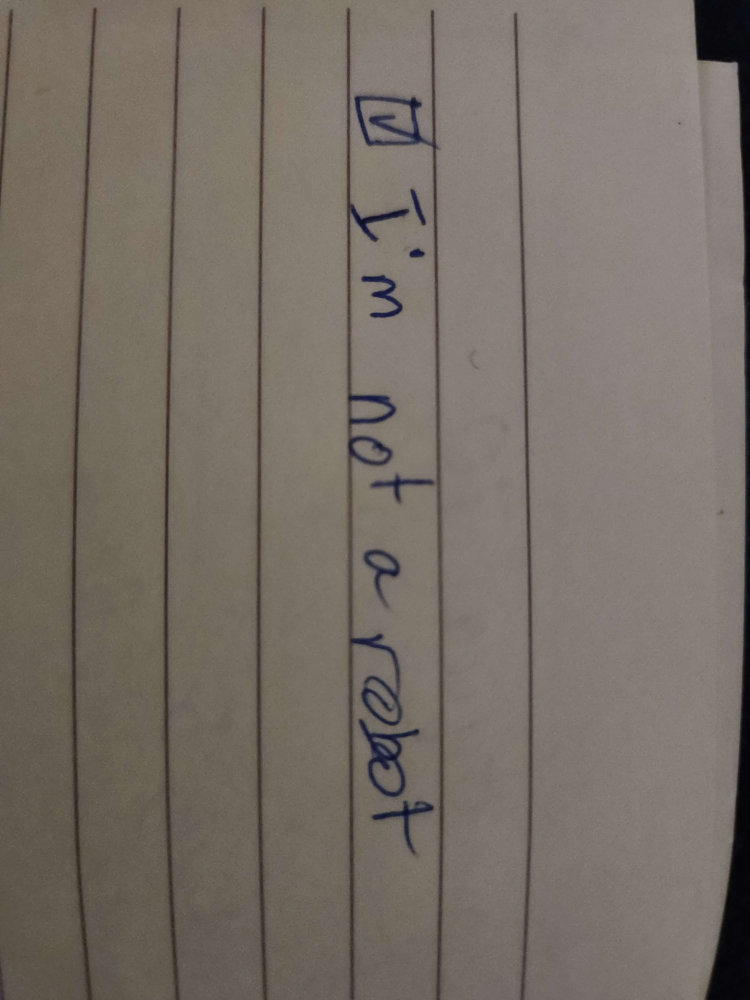

In [1]:
import os
import requests

from azure.ai.vision.imageanalysis import ImageAnalysisClient
from azure.core.credentials import AzureKeyCredential
from dotenv import load_dotenv
from PIL import Image, ImageDraw, ImageFont

load_dotenv(override=True)
endpoint = os.environ.get("AZURE_VISION_ENDPOINT")
api_key = os.environ.get("AZURE_VISION_API_KEY")
credential = AzureKeyCredential(api_key)

image_analysis_client = ImageAnalysisClient(endpoint, credential)

image_path = 'read_me.jpg'
with open(image_path, 'rb') as f:
    image_data = f.read()

image = Image.open(image_path)

image

{'modelVersion': '2023-10-01', 'metadata': {'width': 3000, 'height': 4000}, 'readResult': {'blocks': [{'lines': [{'text': "I'm not a robot", 'boundingPolygon': [{'x': 1712, 'y': 324}, {'x': 1741, 'y': 3443}, {'x': 1419, 'y': 3447}, {'x': 1395, 'y': 325}], 'words': [{'text': "I'm", 'boundingPolygon': [{'x': 1715, 'y': 787}, {'x': 1724, 'y': 1250}, {'x': 1395, 'y': 1258}, {'x': 1401, 'y': 791}], 'confidence': 0.584}, {'text': 'not', 'boundingPolygon': [{'x': 1728, 'y': 1528}, {'x': 1735, 'y': 2031}, {'x': 1396, 'y': 2046}, {'x': 1395, 'y': 1538}], 'confidence': 0.992}, {'text': 'a', 'boundingPolygon': [{'x': 1736, 'y': 2185}, {'x': 1738, 'y': 2360}, {'x': 1406, 'y': 2377}, {'x': 1400, 'y': 2201}], 'confidence': 0.989}, {'text': 'robot', 'boundingPolygon': [{'x': 1739, 'y': 2514}, {'x': 1741, 'y': 3347}, {'x': 1466, 'y': 3372}, {'x': 1412, 'y': 2533}], 'confidence': 0.934}]}]}]}}


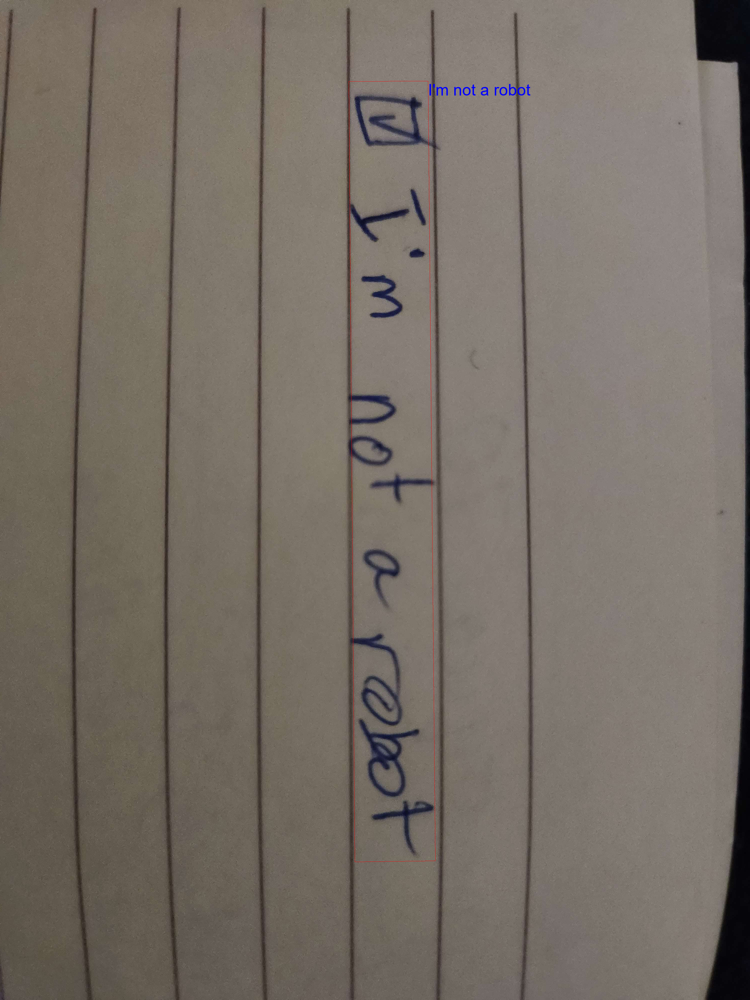

In [4]:
from azure.ai.vision.imageanalysis.models import VisualFeatures

image = Image.open(image_path)
draw = ImageDraw.Draw(image)
font = ImageFont.truetype("arial.ttf", 64)

image_analysis = image_analysis_client.analyze(
    image_data=image_data, visual_features=[VisualFeatures.READ]
)
print(image_analysis)

for block in image_analysis.read.blocks:
    for line in block.lines:
        text = line.text
        polygon = line.bounding_polygon

        points = [(point['x'], point['y']) for point in polygon]
        draw.polygon(points, outline='red')
        draw.text((points[0][0], points[0][1]), text, fill='blue', font=font)

image